# Used Car Prices CarGurus: Catboost GPU
## Weights & Biases Optuna Hyperparameter Optimization

## Set Up Environment, Read Data, Prepare for Modeling

# Quadro RTX 4000

In [ ]:
# Install/import dependencies
!pip install --upgrade pip
!pip install xgboost==1.5.2
!pip install --upgrade -q wandb
!pip install optuna
!pip install plotly
!pip install shap
!pip install eli5
import os
import warnings
import random
import numpy as np
import cupy 
from cupy import asnumpy
import dask
from dask.distributed import Client, wait
from dask.diagnostics import ProgressBar
from dask_cuda import LocalCUDACluster
import dask_cudf
import urllib.request
from contextlib import contextmanager
import time
from datetime import datetime, timedelta
from timeit import default_timer as timer
import joblib
import cudf
import cuml
from xgboost import XGBRegressor, plot_importance
import optuna
from optuna import Trial
optuna.logging.set_verbosity(optuna.logging.WARNING) 
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
import pickle
import pandas as pd
import plotly.offline as py
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns
import eli5 
from eli5.sklearn import PermutationImportance 
import webbrowser
from eli5.formatters import format_as_dataframe
warnings.filterwarnings('ignore')
my_dpi = 96
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
print('\n')
!nvidia-smi

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 56.6 MB/s eta 0:00:00:00:01
  Attempting uninstall: pip
    Found existing installation: pip 22.0.3
    Uninstalling pip-22.0.3:
      Successfully uninstalled pip-22.0.3
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 365.3/365.3 kB 35.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 210.6/210.6 kB 40.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 75.4 MB/s eta 0:00:00:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 20.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 610.9/610.9 kB 63.9 MB/s eta 0:00:00
  Attempting uninstall: typing-extensions
    Found existing installation: typing_extensions 4.0.1
    Uninstalling typing_extensions-4.0.1:
      Successfully uninstalled typing_extensions-4.0.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency con

In [ ]:
# Set seed 
seed_value = 42
os.environ['xgbRAPIDS_GPU'] = str(seed_value)
random.seed(seed_value)
cupy.random.seed(seed_value)
np.random.seed(seed_value)

In [ ]:
# Set up local CUDA cluster for Dask
cluster = LocalCUDACluster(threads_per_worker=1, ip='', 
                           dashboard_address='8082') 
c = Client(cluster)

# Query the client for all connected workers
workers = c.has_what().keys()
n_workers = len(workers)
c

distributed.preloading - INFO - Import preload module: dask_cuda.initialize


Connection method: Cluster object,Cluster type: dask_cuda.LocalCUDACluster
Dashboard: http://10.42.31.5:36387/status,
Dashboard: http://10.42.31.5:36387/status,Workers: 1
Total threads: 1,Total memory: 26.44 GiB
Status: running,Using processes: True
Comm: tcp://10.42.31.5:34071,Workers: 1
Dashboard: http://10.42.31.5:36387/status,Total threads: 1
Started: Just now,Total memory: 26.44 GiB
Comm: tcp://10.42.31.5:33047,Total threads: 1
Dashboard: http://10.42.31.5:33123/status,Memory: 26.44 GiB
Nanny: tcp://10.42.31.5:42881,


In [ ]:
# Define function to time code blocks
@contextmanager
def timed(name):
    t0 = time.time()
    yield
    t1 = time.time()
    print('..%-24s:  %8.4f' % (name, t1 - t0))

In [ ]:
%cd /notebooks/UsedCarsCarGurus/Data/

/notebooks/UsedCarsCarGurus/Data


In [ ]:
# Read data 
trainDF = cudf.read_csv('usedCars_trainSet.csv', low_memory=False)
testDF = cudf.read_csv('usedCars_testSet.csv', low_memory=False)

# Define label and features
train_label = trainDF[['price']]
test_label = testDF[['price']]

train_features = trainDF.drop(columns = ['price'])
test_features = testDF.drop(columns = ['price'])

# Create dummy variables for categorical variables
train_features = cudf.get_dummies(train_features)
test_features = cudf.get_dummies(test_features)

In [ ]:
# Convert data type for modeling
train_features = train_features.astype('float32')
train_label = train_label.astype('int32')

test_features = test_features.astype('float32')
test_label = test_label.astype('int32')

train_features = train_features.to_cupy()
train_label = train_label.to_cupy()
test_features = test_features.to_cupy()
test_label = test_label.to_cupy()

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_xgbGPU_setParams', 
                'save_code': 'False', 
                'notes': 'xgbGPU_setParams_RTX4000_trainTest'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    '''
    Objective function to tune a `XGBoostRegressor` model.
    '''
    joblib.dump(study, 'XGB_Optuna_GPU_setParams_RTX4000_cuml_wb.pkl')

    # Define parameter grid
    params_xgb_optuna = {
        'n_estimators': trial.suggest_int('n_estimators', 600, 800, step=100),
        'max_depth': trial.suggest_int('max_depth', 14, 15),
        'subsample': trial.suggest_float('subsample', 0.78, 0.8, step=0.02),
        'reg_lambda': trial.suggest_float('reg_lambda', 5.5, 7.5, step=1),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 0.7, 
                                                step=0.1),
        'colsample_bylevel': trial.suggest_float('colsample_bylevel', 0.4, 0.6, 
                                                 step=0.1), 
        'min_child_weight': trial.suggest_int('min_child_weight', 7, 9, step=1),
        }
    
    # Start timer for each trial
    start = timer()

      # Define model type   
    model = XGBRegressor(objective='reg:squarederror',
                         booster='gbtree', 
                         tree_method='gpu_hist',
                         gamma=4.5,
                         learning_rate=0.04,
                         reg_alpha=0.01,
                         scale_pos_weight=1,
                         use_label_encoder=False,
                         random_state=seed_value,
                         verbosity=0,
                         **params_xgb_optuna)
      
    # Train the model
    model.fit(train_features, train_label, 
              eval_set = [(test_features, test_label), 
                          (train_features, train_label)],
              verbose=False) 
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(test_features)
    rmse = mean_squared_error(asnumpy(test_label), asnumpy(y_pred_val), 
                              squared=False)
    print('Trial RMSE:', rmse)
        
    return rmse       

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('XGB_Optuna_GPU_setParams_RTX4000_cuml_wb.pkl'):
    study = joblib.load('XGB_Optuna_GPU_setParams_RTX4000_cuml_wb.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=200, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-01-31 06:13:33.434833


Trial RMSE: 2318.7115763194774


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2319.7158646272956


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2327.883171039906


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2324.3812545296264


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2330.447377825501


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


Trial RMSE: 2325.7036210738374


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


Trial RMSE: 2331.335297068495


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2316.9226670583016


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2322.7686704221487


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2327.154106973055


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2321.189737982576


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2317.138387531705


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2317.138387531705


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2318.1082502281815


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2316.556003030448


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2319.8399694933605


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.556003030448


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2319.2464816972947


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


Trial RMSE: 2316.556003030448


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2320.5951069836856


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2315.799085261541


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2315.799085261541


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2315.799085261541


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2315.799085261541


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2315.9272547521628


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2316.441373634785


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2315.799085261541


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2315.9272547521628


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2316.865148083233


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2318.3381722238973


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2313.2053941308345


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2313.2053941308345


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2313.2053941308345


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2313.2053941308345


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2316.833038020175


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2315.4759575900644


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2313.2053941308345


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2318.9016222849286


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2312.6191006101903


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2320.3066694445324


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


Trial RMSE: 2322.6220488706804


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.6191006101903


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.6191006101903


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.6191006101903


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.6191006101903


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2319.389311590561


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2316.8269449475965


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2319.7281569745837


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2320.2125609583454


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2320.3066694445324


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2316.8269449475965


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2317.6878340000153


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2319.9023082099466


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2319.7281569745837


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2316.8269449475965


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2320.3066694445324


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


Trial RMSE: 2317.6878340000153


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2319.9023082099466


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2313.6221124725107


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2316.7608734208743


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2323.9169561384024


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2326.9684496120376


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2320.3066694445324


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2316.2895908045325


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'},inplace=True)
trials_df.rename(columns={'params_colsample_bylevel': 'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma': 'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight': 'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha': 'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda': 'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('XGBoost_Optuna_GPU_setParams_RTX4000_cuml_wb.csv', 
                 index=False)
print(trials_df) 

     iteration         rmse             datetime_start  \
194        194  2312.352386 2023-01-31 12:05:43.582792   
100        100  2312.352386 2023-01-31 09:15:59.539169   
99          99  2312.352386 2023-01-31 09:14:08.442551   
98          98  2312.352386 2023-01-31 09:12:19.977672   
144        144  2312.352386 2023-01-31 10:35:03.036800   
..         ...          ...                        ...   
9            9  2327.154107 2023-01-31 06:25:41.126599   
2            2  2327.883171 2023-01-31 06:16:21.033607   
4            4  2330.447378 2023-01-31 06:18:56.127730   
6            6  2331.335297 2023-01-31 06:21:31.186435   
195        195          NaN 2023-01-31 12:07:32.981542   

             datetime_complete               duration  colsample_bylevel  \
194 2023-01-31 12:07:28.320389 0 days 00:01:44.737597                0.6   
100 2023-01-31 09:17:42.737739 0 days 00:01:43.198570                0.6   
99  2023-01-31 09:15:52.662983 0 days 00:01:44.220432                0.6   

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_XGBoost_Optuna_GPU_setParams_RTX4000_cuml_wb.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_XGBoost_Optuna_GPU_setParams_RTX4000_cuml_wb.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_XGBoost_Optuna_GPU_setParams_RTX4000_cuml_wb.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth', 
                                                       'reg_lambda',
                                                       'colsample_bytree',
                                                       'colsample_bylevel'])
py.plot(fig, filename='contour_XGBoost_Optuna_GPU_setParams_RTX4000_cuml_wb.html')
fig.show()

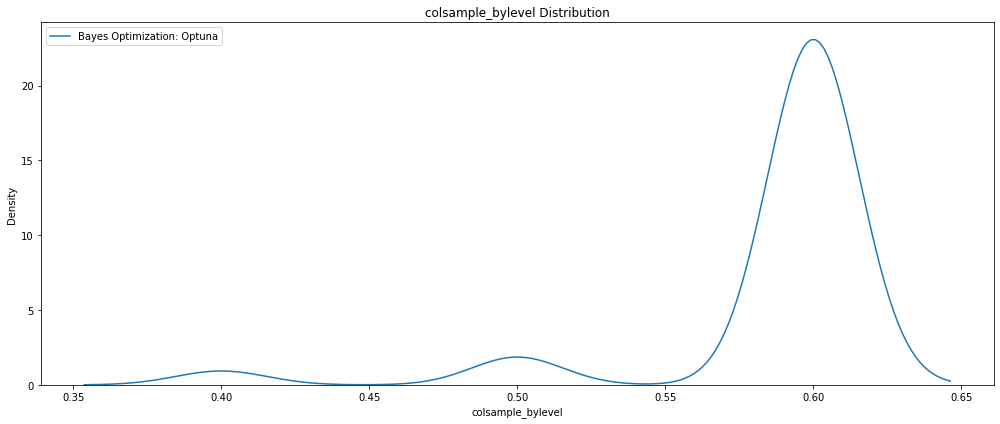

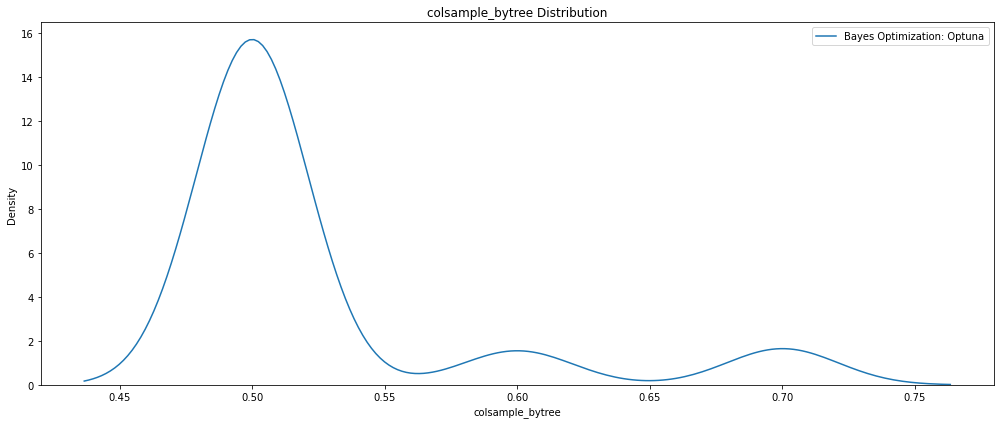

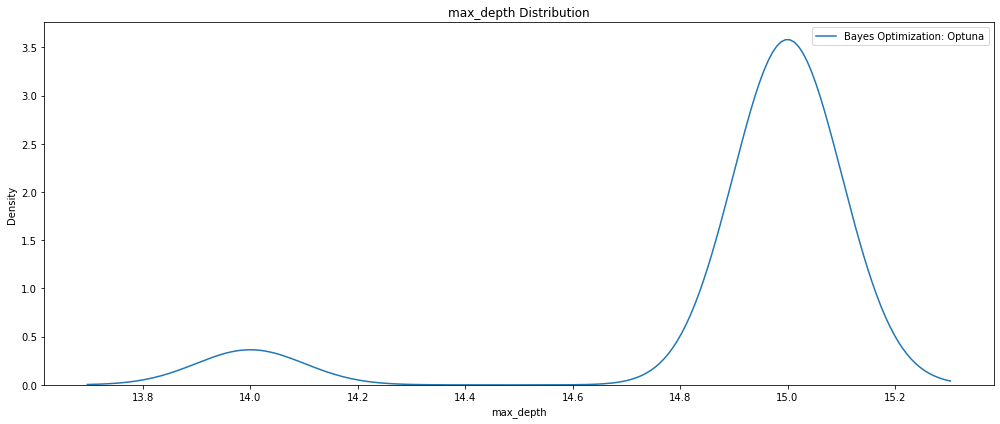

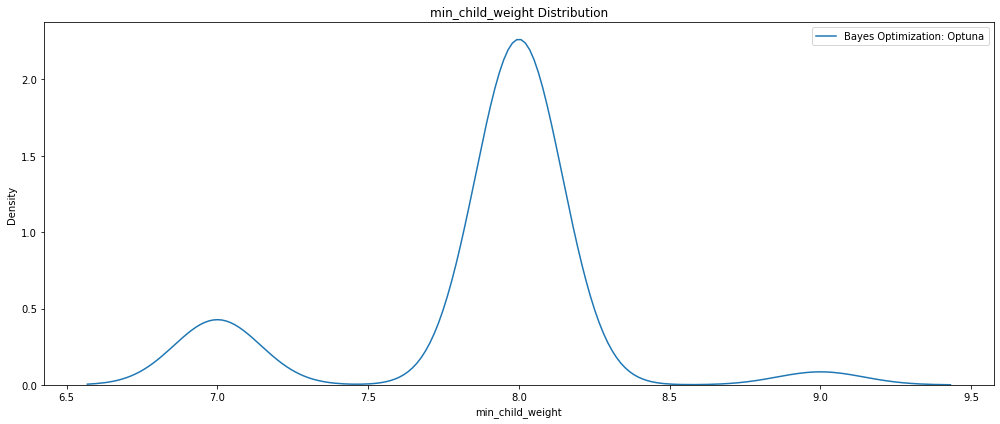

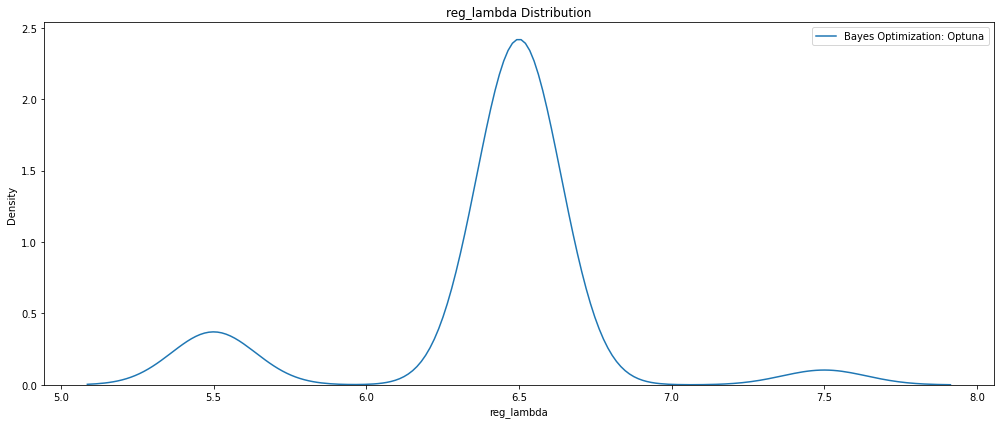

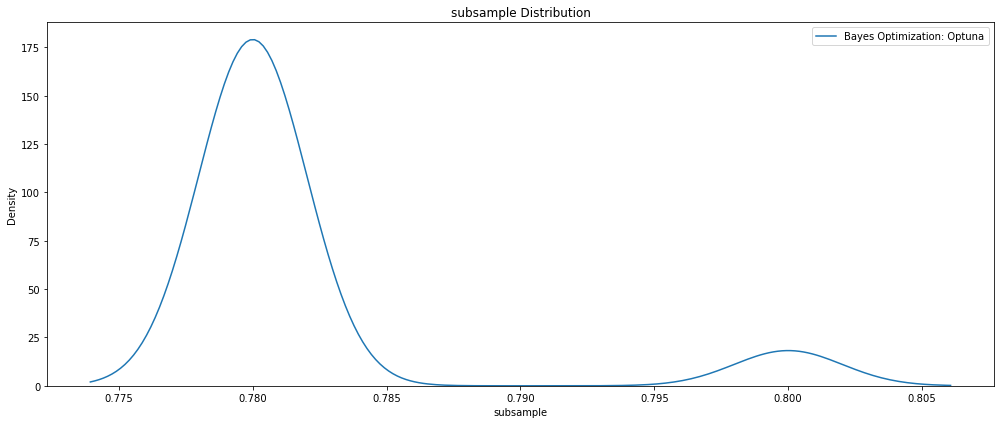

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

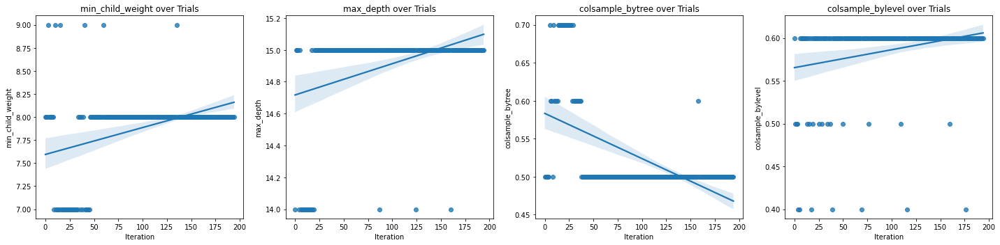

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
for i, hpo in enumerate(['min_child_weight', 'max_depth', 
                         'colsample_bytree', 'colsample_bylevel']): 
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_XGBoost_Optuna_GPU_setParams_RTX4000_cuml_wb.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_XGBoost_Optuna_GPU_setParams_RTX4000_cuml_wb.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params

{'n_estimators': 800,
 'max_depth': 15,
 'subsample': 0.78,
 'reg_lambda': 6.5,
 'colsample_bytree': 0.5,
 'colsample_bylevel': 0.6,
 'min_child_weight': 8,
 'random_state': 42,
 'metric': 'rmse'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = XGBRegressor(objective='reg:squarederror', 
                          booster='gbtree',
                          tree_method='gpu_hist', 
                          scale_pos_weight=1,
                          gamma=4.5,
                          learning_rate=0.04,
                          reg_alpha=0.01,
                          use_label_encoder=False,
                          verbosity=0, 
                          **params)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'XGB_Optuna_trials_GPU_setParams_RTX4000_cuml_wb.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('XGB_Optuna_trials_GPU_setParams_RTX4000_cuml_wb.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for XGBoost HPO GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_absolute_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred), 
                           squared=False),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred), 
                           squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(asnumpy(train_label), asnumpy(y_train_pred)),
        r2_score(asnumpy(test_label), asnumpy(y_test_pred))))


Model Metrics for XGBoost HPO GPU trials
MAE train: 968.912, test: 1680.328
MSE train: 1809196.456, test: 5346973.555
RMSE train: 1345.064, test: 2312.352
R^2 train: 0.980, test: 0.941


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(asnumpy(test_label), 
                                                                                                      asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 5346973.55547 MSE on the test set.
This was achieved using these conditions:
iteration                                   194
rmse                                2312.352386
datetime_start       2023-01-31 12:05:43.582792
datetime_complete    2023-01-31 12:07:28.320389
duration                 0 days 00:01:44.737597
colsample_bylevel                           0.6
colsample_bytree                            0.5
max_depth                                  15.0
min_child_weight                            8.0
n_estimators                              800.0
reg_lambda                                  6.5
subsample                                  0.78
state                                  COMPLETE
Name: 194, dtype: object


# Quadro RTX 5000

In [ ]:
# Install/import dependencies
!pip install --upgrade pip
!pip install xgboost==1.5.2
!pip install --upgrade -q wandb
!pip install optuna
!pip install plotly
!pip install shap
!pip install eli5
import os
import warnings
import random
import numpy as np
import cupy 
from cupy import asnumpy
import dask
from dask.distributed import Client, wait
from dask.diagnostics import ProgressBar
from dask_cuda import LocalCUDACluster
import dask_cudf
import urllib.request
from contextlib import contextmanager
import time
from datetime import datetime, timedelta
from timeit import default_timer as timer
import joblib
import cudf
import cuml
from sklearn.model_selection import cross_val_score, KFold
from xgboost import XGBRegressor, plot_importance
import optuna
from optuna import Trial
optuna.logging.set_verbosity(optuna.logging.WARNING) 
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
import pickle
import pandas as pd
import plotly.offline as py
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns
import eli5 
from eli5.sklearn import PermutationImportance 
import webbrowser
from eli5.formatters import format_as_dataframe
warnings.filterwarnings('ignore')
my_dpi = 96
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
print('\n')
!nvidia-smi



Sat Feb  4 23:02:57 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.73.05    Driver Version: 510.73.05    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Quadro RTX 5000     Off  | 00000000:00:05.0 Off |                  Off |
| 33%   30C    P2    39W / 230W |    920MiB / 16384MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_xgbGPU_setParams', 
                'save_code': 'False', 
                'notes': 'xgbGPU_setParams_RTX5000_trainTest'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    '''
    Objective function to tune a `XGBoostRegressor` model.
    '''
    joblib.dump(study, 'XGB_Optuna_GPU_setParams_RTX5000_cuml_wb.pkl')

    # Define parameter grid
    params_xgb_optuna = {
        'n_estimators': trial.suggest_int('n_estimators', 600, 800, step=100),
        'max_depth': trial.suggest_int('max_depth', 14, 15),
        'subsample': trial.suggest_float('subsample', 0.78, 0.8, step=0.02),
        'reg_lambda': trial.suggest_float('reg_lambda', 5.5, 7.5, step=1),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 0.7, 
                                                step=0.1),
        'colsample_bylevel': trial.suggest_float('colsample_bylevel', 0.4, 0.6, 
                                                 step=0.1), 
        'min_child_weight': trial.suggest_int('min_child_weight', 7, 9, step=1),
        }
    
    # Start timer for each trial
    start = timer()

    # Define model type   
    model = XGBRegressor(objective='reg:squarederror',
                         booster='gbtree', 
                         tree_method='gpu_hist',
                         gamma=4.5,
                         learning_rate=0.04,
                         reg_alpha=0.01,
                         scale_pos_weight=1,
                         use_label_encoder=False,
                         random_state=seed_value,
                         verbosity=0,
                         **params_xgb_optuna)
      
    # Train the model
    model.fit(train_features, train_label, 
              eval_set = [(test_features, test_label), 
                          (train_features, train_label)],
              verbose=False) 
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(test_features)
    rmse = mean_squared_error(asnumpy(test_label), asnumpy(y_pred_val), 
                              squared=False)
    print('Trial RMSE:', rmse)
        
    return rmse             

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('XGB_Optuna_GPU_setParams_RTX5000_cuml_wb.pkl'):
    study = joblib.load('XGB_Optuna_GPU_setParams_RTX5000_cuml_wb.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=200, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-01-29 03:53:35.479179


Trial RMSE: 2318.479966781926


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2328.982986202183


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


Trial RMSE: 2320.139114568156


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2318.5269782608607


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2322.271980514106


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


Trial RMSE: 2319.2438151062547


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2328.2124224613763


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


Trial RMSE: 2316.3702997699497


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2318.197905307442


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2318.426567002332


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2317.7091557934286


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2317.7091557934286


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2317.7091557934286


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2316.943760088091


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2319.683246784686


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2317.5039060873714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2317.8048664177463


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2324.453353833955


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2319.7281569745837


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2319.7281569745837


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2317.4557781318435


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2320.647497747826


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2317.5951793682775


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2317.4859422330364


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2319.9596104196244


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2323.9169561384024


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2324.453353833955


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2316.3046557153834


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2323.1379628303907


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2318.901139564679


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2318.426567002332


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2314.970290521618


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2334.5733515115717


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2317.6878340000153


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2317.584592781976


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2318.901139564679


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2318.476691860999


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2324.600200607543


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2316.8269449475965


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2321.107449366911


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2323.377358453342


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2317.6878340000153


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2316.8269449475965


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2317.690467707812


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2320.3066694445324


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2319.9023082099466


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2317.6878340000153


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2317.690467707812


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2319.9023082099466


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2318.616181780741


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2317.6878340000153


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2320.3066694445324


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2316.7608734208743


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'},inplace=True)
trials_df.rename(columns={'params_colsample_bylevel': 'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma': 'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight': 'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha': 'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda': 'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('XGBoost_Optuna_GPU_setParams_RTX5000_cuml_wb.csv', 
                 index=False)
print(trials_df) 

     iteration         rmse             datetime_start  \
197        197  2312.352386 2023-01-29 09:32:55.950640   
97          97  2312.352386 2023-01-29 06:30:36.897975   
196        196  2312.352386 2023-01-29 09:31:08.693468   
99          99  2312.352386 2023-01-29 06:34:07.430225   
100        100  2312.352386 2023-01-29 06:35:52.042404   
..         ...          ...                        ...   
59          59  2324.600201 2023-01-29 05:26:01.754355   
6            6  2328.212422 2023-01-29 04:03:05.512830   
1            1  2328.982986 2023-01-29 03:55:22.811804   
48          48  2334.573352 2023-01-29 05:09:01.127039   
198        198          NaN 2023-01-29 09:34:41.509700   

             datetime_complete               duration  colsample_bylevel  \
197 2023-01-29 09:34:37.275457 0 days 00:01:41.324817                0.6   
97  2023-01-29 06:32:17.047692 0 days 00:01:40.149717                0.6   
196 2023-01-29 09:32:49.484048 0 days 00:01:40.790580                0.6   

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_XGBoost_Optuna_GPU_setParams_RTX5000_cuml_wb.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_XGBoost_Optuna_GPU_setParams_RTX5000_cuml_wb.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_XGBoost_Optuna_GPU_setParams_RTX5000_cuml_wb.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth', 
                                                       'reg_lambda',
                                                       'colsample_bytree',
                                                       'colsample_bylevel'])
py.plot(fig, filename='contour_XGBoost_Optuna_GPU_setParams_RTX5000_cuml_wb_gammaMax1.html')
fig.show()

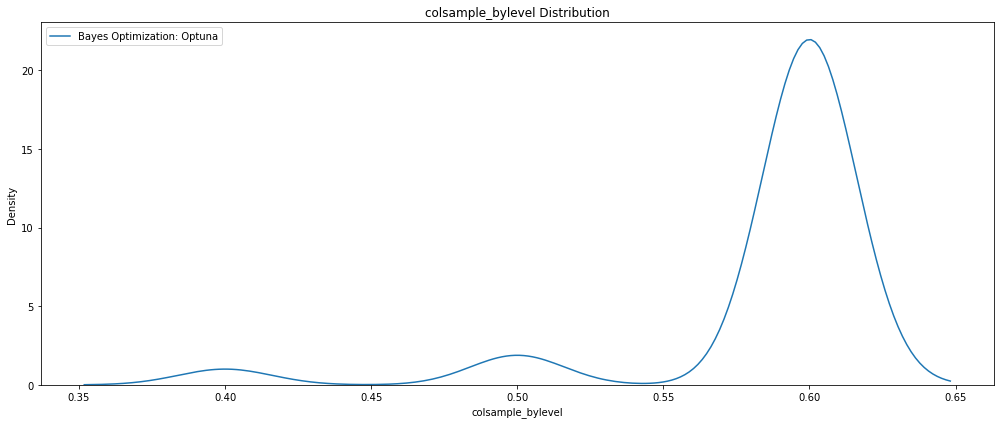

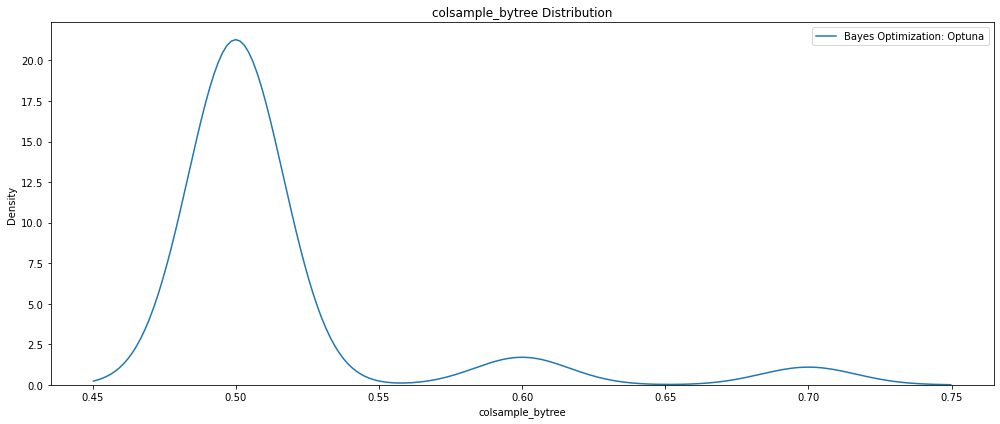

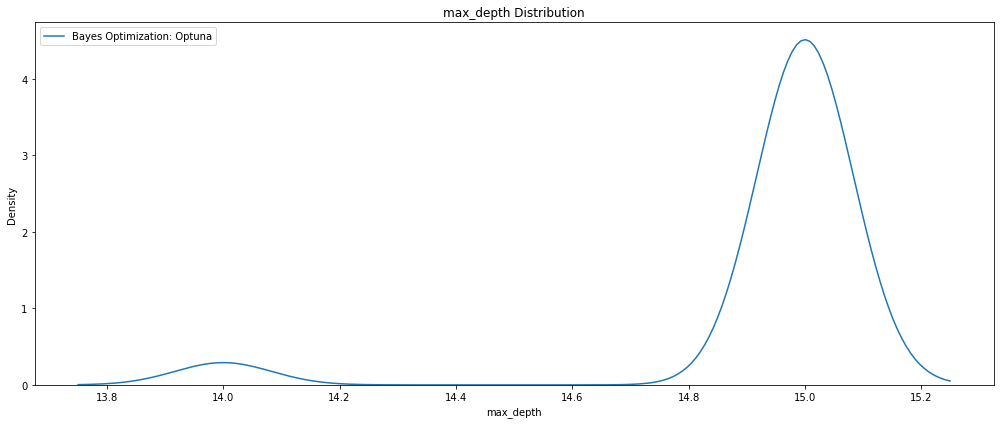

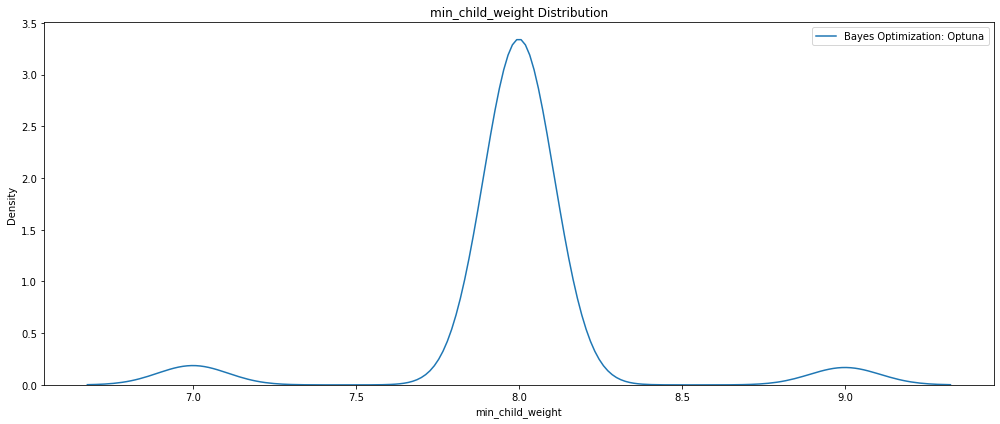

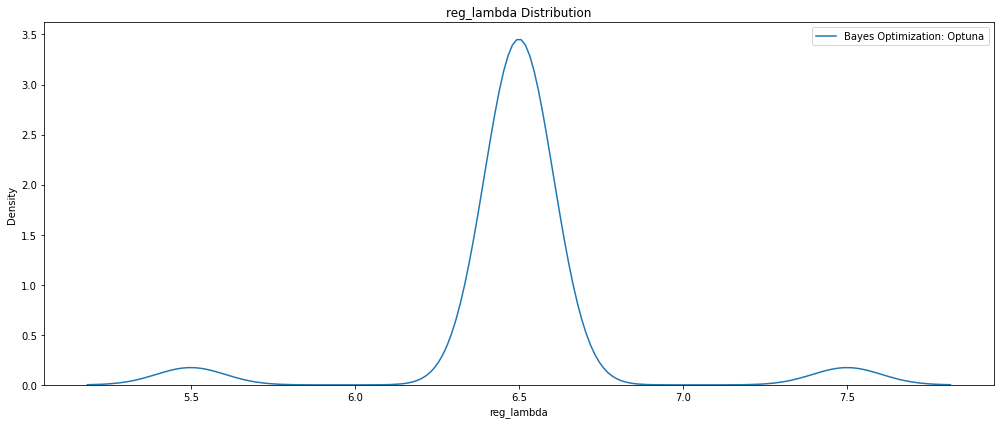

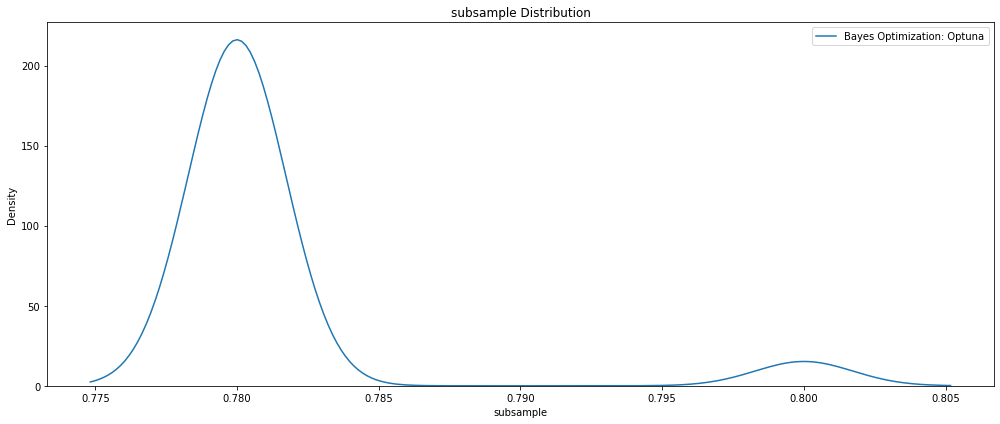

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

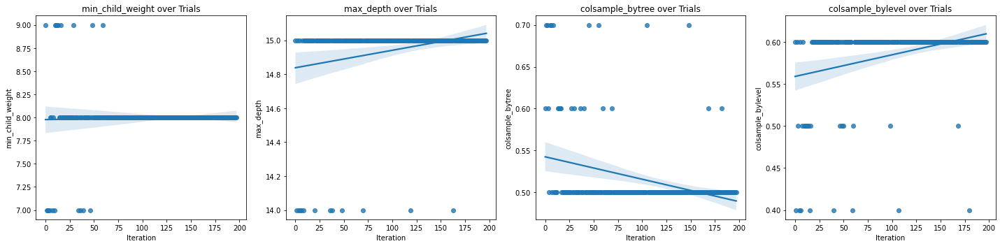

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
for i, hpo in enumerate(['min_child_weight', 'max_depth', 
                         'colsample_bytree', 'colsample_bylevel']): 
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_XGBoost_Optuna_GPU_setParams_RTX5000_cuml_wb.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_XGBoost_Optuna_GPU_setParams_RTX5000_cuml_wb.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params

{'n_estimators': 800,
 'max_depth': 15,
 'subsample': 0.78,
 'reg_lambda': 6.5,
 'colsample_bytree': 0.5,
 'colsample_bylevel': 0.6,
 'min_child_weight': 8,
 'random_state': 42,
 'metric': 'rmse'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = XGBRegressor(objective='reg:squarederror', 
                          booster='gbtree',
                          tree_method='gpu_hist', 
                          scale_pos_weight=1,
                          use_label_encoder=False,
                          verbosity=0, 
                          **params)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'XGB_Optuna_trials_GPU_setParams_RTX5000_cuml_wb.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('XGB_Optuna_trials_GPU_setParams_RTX5000_cuml_wb.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for XGBoost HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_absolute_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred), 
                           squared=False),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred), 
                           squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(asnumpy(train_label), asnumpy(y_train_pred)),
        r2_score(asnumpy(test_label), asnumpy(y_test_pred))))


Model Metrics for XGBoost HPO 100 GPU trials
MAE train: 66.553, test: 1840.116
MSE train: 25637.412, test: 6468362.481
RMSE train: 160.117, test: 2543.298
R^2 train: 1.000, test: 0.929


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(asnumpy(test_label), 
                                                                                                      asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6468362.48109 MSE on the test set.
This was achieved using these conditions:
iteration                                   197
rmse                                2312.352386
datetime_start       2023-01-29 09:32:55.950640
datetime_complete    2023-01-29 09:34:37.275457
duration                 0 days 00:01:41.324817
colsample_bylevel                           0.6
colsample_bytree                            0.5
max_depth                                  15.0
min_child_weight                            8.0
n_estimators                              800.0
reg_lambda                                  6.5
subsample                                  0.78
state                                  COMPLETE
Name: 197, dtype: object


# RTX A4000

In [ ]:
!pip install --upgrade pip
!pip install --upgrade -q wandb
!pip install catboost
!pip install optuna
!pip install plotly
!pip install eli5
!pip install shap
import os
import warnings
import random
import numpy as np
import cupy 
from cupy import asnumpy
import dask
from dask.distributed import Client, wait
from dask.diagnostics import ProgressBar
from dask_cuda import LocalCUDACluster
import dask_cudf
import urllib.request
from contextlib import contextmanager
import time
from datetime import datetime, timedelta
from timeit import default_timer as timer
import joblib
import cudf
import cuml
from xgboost import XGBRegressor, plot_importance
import optuna
from optuna import Trial
optuna.logging.set_verbosity(optuna.logging.WARNING) 
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
import pickle
import pandas as pd
import plotly.offline as py
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns
import eli5 
from eli5.sklearn import PermutationImportance 
import webbrowser
from eli5.formatters import format_as_dataframe
warnings.filterwarnings('ignore')
my_dpi = 96
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
print('\n')
!nvidia-smi

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 24.1 MB/s eta 0:00:0000:0100:01
  Attempting uninstall: pip
    Found existing installation: pip 22.0.3
    Uninstalling pip-22.0.3:
      Successfully uninstalled pip-22.0.3
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.6/76.6 MB 24.2 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.0/47.0 kB 13.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.2/15.2 MB 81.1 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 365.3/365.3 kB 29.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 59.3 MB/s eta 0:00:0000:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 210.6/210.6 kB 35.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 26.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 610.9/610.9 kB 50.1 MB/s eta 0:00:00
  Attempting uninstall: typing-extensions
    Found existing installation: typing_extensions 4.0.

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_xgbGPU_setParams', 
                'save_code': 'False', 
                'notes': 'xgbGPU_setParams_A4000_trainTest'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    '''
    Objective function to tune a `XGBoostRegressor` model.
    '''
    joblib.dump(study, 'XGB_Optuna_GPU_setParams_A4000_cuml_wb.pkl')

    # Define parameter grid
    params_xgb_optuna = {
        'n_estimators': trial.suggest_int('n_estimators', 600, 800, step=100),
        'max_depth': trial.suggest_int('max_depth', 14, 15),
        'subsample': trial.suggest_float('subsample', 0.78, 0.8, step=0.02),
        'reg_lambda': trial.suggest_float('reg_lambda', 5.5, 7.5, step=1),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 0.7, 
                                                step=0.1),
        'colsample_bylevel': trial.suggest_float('colsample_bylevel', 0.4, 0.6, 
                                                 step=0.1), 
        'min_child_weight': trial.suggest_int('min_child_weight', 7, 9, step=1),
        }
    
    # Start timer for each trial
    start = timer()

    # Define model type   
    model = XGBRegressor(objective='reg:squarederror',
                         booster='gbtree', 
                         tree_method='gpu_hist',
                         gamma=4.5,
                         learning_rate=0.04,
                         reg_alpha=0.01,
                         scale_pos_weight=1,
                         use_label_encoder=False,
                         random_state=seed_value,
                         verbosity=0,
                         **params_xgb_optuna)
      
    # Train the model
    model.fit(train_features, train_label, 
              eval_set = [(test_features, test_label), 
                          (train_features, train_label)],
              verbose=False) 
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(test_features)
    rmse = mean_squared_error(asnumpy(test_label), asnumpy(y_pred_val), 
                              squared=False)
    print('Trial RMSE:', rmse)
        
    return rmse      

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('XGB_Optuna_GPU_setParams_A4000_cuml_wb.pkl'):
    study = joblib.load('XGB_Optuna_GPU_setParams_A4000_cuml_wb.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=200, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-01-29 20:34:51.727298


Trial RMSE: 2316.9264178275434


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2317.460770769167


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2327.648496696072


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2320.139114568156


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2318.2487728989017


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2315.7620173414557


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2327.883171039906


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2324.472610609707


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.3702997699497


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2322.566746388046


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2321.8088311703546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


Trial RMSE: 2316.7608734208743


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2320.3066694445324


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


Trial RMSE: 2318.479966781926


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2324.147127950814


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2315.9272547521628


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2319.5557660341756


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2318.197905307442


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2315.9272547521628


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2317.0506760779635


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2324.415911700967


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2315.9272547521628


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2315.9272547521628


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2317.273270276269


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2318.058787456558


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2316.833038020175


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2319.5427389295064


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2316.865148083233


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2317.273270276269


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2316.2064571347605


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2318.8319418708866


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2319.3833025490035


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2315.6701138407516


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2323.4226375601106


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2317.1592815559957


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2315.4938798768853


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2321.5769744740246


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2323.2267082060607


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2320.2470362616577


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.984892208367


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2317.1592815559957


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2316.558636065126


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2315.6701138407516


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2321.5208070597014


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.947165411038


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2315.3719167898616


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2317.273270276269


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2316.0470998513783


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2315.4938798768853


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2315.6701138407516


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2326.4393743165974


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2316.558636065126


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2315.3719167898616


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.947165411038


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2316.558636065126


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2321.5208070597014


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2315.4938798768853


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2316.0470998513783


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2315.3719167898616


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2315.6701138407516


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


In [ ]:
# Load to continue training
study = joblib.load('XGB_Optuna_GPU_setParams_A4000_cuml_wb.pkl')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)

Number of finished trials: 199
Best trial: {'n_estimators': 700, 'max_depth': 15, 'subsample': 0.78, 'reg_lambda': 5.5, 'colsample_bytree': 0.6, 'colsample_bylevel': 0.6, 'min_child_weight': 7}
Lowest RMSE 2314.3974382951546


In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('XGB_Optuna_GPU_setParams_A4000_cuml_wb.pkl'):
    study = joblib.load('XGB_Optuna_GPU_setParams_A4000_cuml_wb.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=2, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-01-30 02:50:52.261584


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2314.3974382951546


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Start Time           2023-01-30 02:50:52.261584
End Time             2023-01-30 02:54:23.183146
0:03:30


Number of finished trials: 201
Best trial: {'n_estimators': 700, 'max_depth': 15, 'subsample': 0.78, 'reg_lambda': 5.5, 'colsample_bytree': 0.6, 'colsample_bylevel': 0.6, 'min_child_weight': 7}
Lowest RMSE 2314.3974382951546


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'},inplace=True)
trials_df.rename(columns={'params_colsample_bylevel': 'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma': 'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight': 'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha': 'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda': 'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('XGBoost_Optuna_GPU_setParams_A4000_cuml_wb.csv', index=False)
print(trials_df) 

     iteration         rmse             datetime_start  \
200        200  2314.397438 2023-01-30 02:52:39.808888   
104        104  2314.397438 2023-01-29 23:43:24.805488   
103        103  2314.397438 2023-01-29 23:41:37.716411   
102        102  2314.397438 2023-01-29 23:39:52.234169   
101        101  2314.397438 2023-01-29 23:38:04.808736   
..         ...          ...                        ...   
7            7  2324.472611 2023-01-29 20:46:42.752611   
119        119  2326.439374 2023-01-30 00:10:05.217617   
2            2  2327.648497 2023-01-29 20:37:58.663821   
6            6  2327.883171 2023-01-29 20:45:15.048684   
198        198          NaN 2023-01-30 02:31:12.665765   

             datetime_complete               duration  colsample_bylevel  \
200 2023-01-30 02:54:18.927181 0 days 00:01:39.118293                0.6   
104 2023-01-29 23:45:06.487079 0 days 00:01:41.681591                0.6   
103 2023-01-29 23:43:18.645268 0 days 00:01:40.928857                0.6   

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_XGBoost_Optuna_GPU_setParams_A4000_cuml_wb.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_XGBoost_Optuna_GPU_setParams_A4000_cuml_wb.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_XGBoost_Optuna_GPU_setParams_A4000_cuml_wb.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth', 
                                                       'reg_lambda',
                                                       'colsample_bytree',
                                                       'colsample_bylevel'])
py.plot(fig, filename='contour_XGBoost_Optuna_GPU_setParams_A4000_cuml_wb.html')
fig.show()

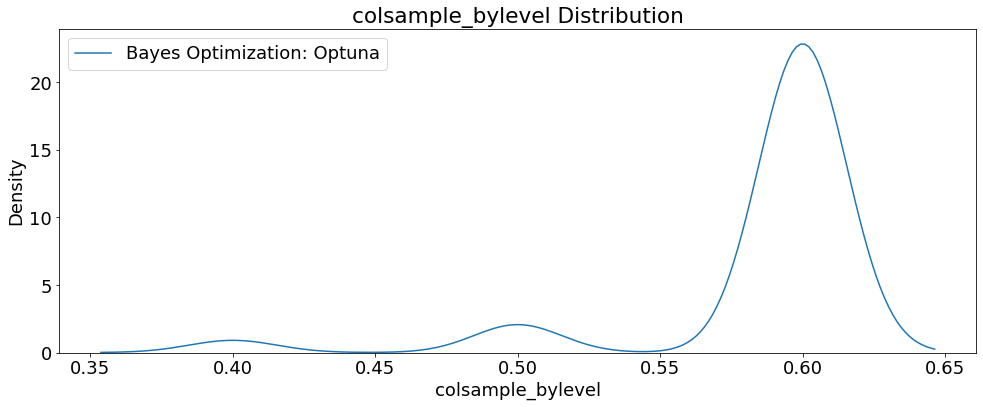

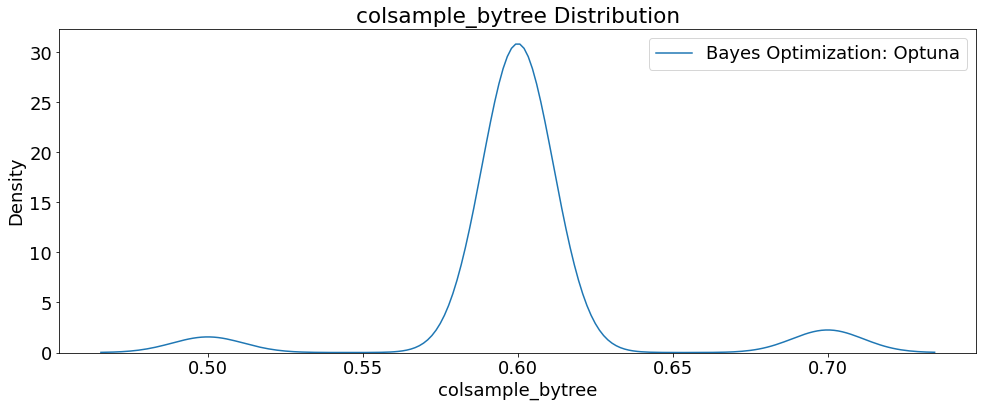

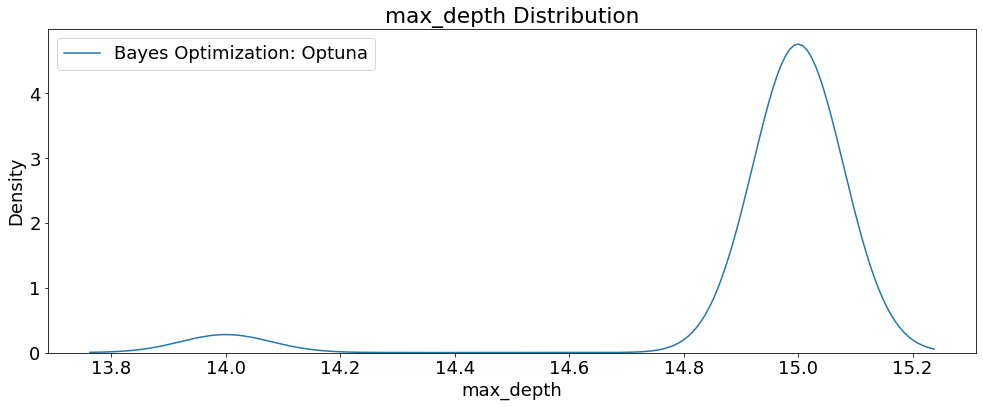

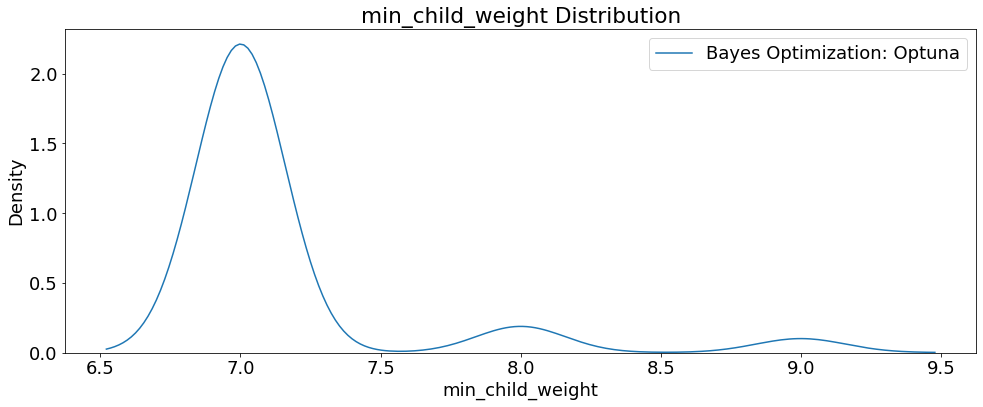

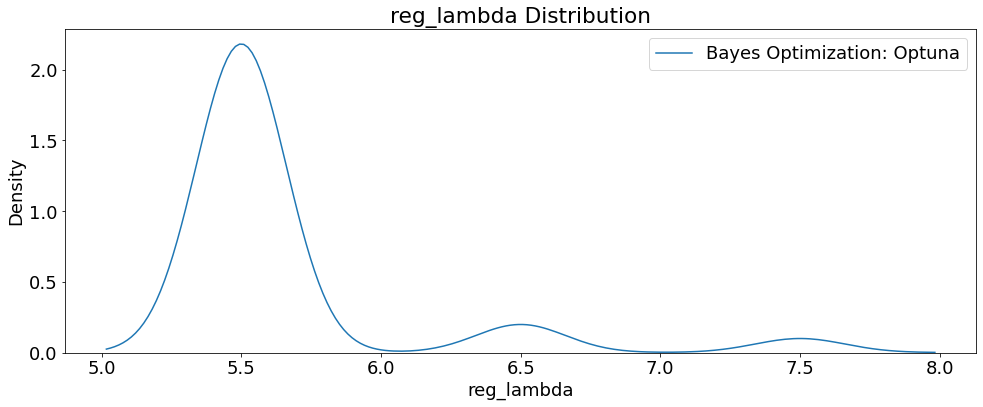

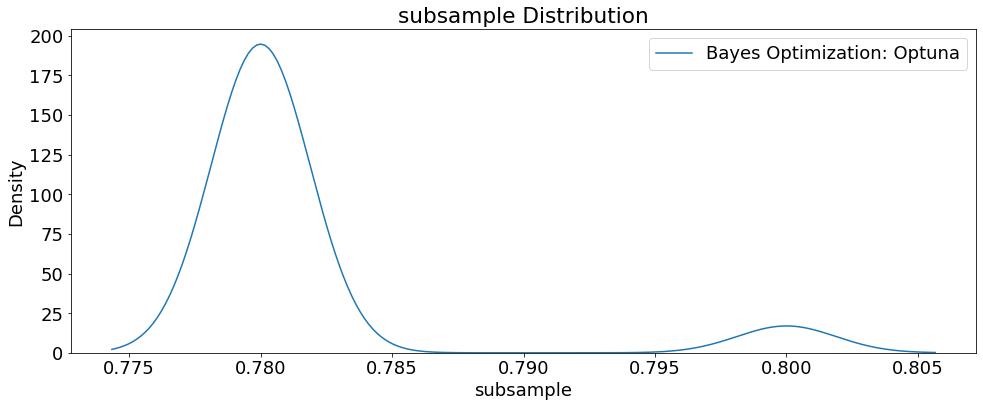

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

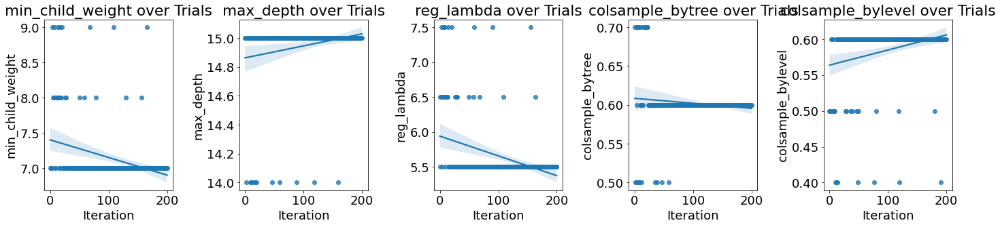

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 5, figsize=(20,5))
i = 0
for i, hpo in enumerate(['min_child_weight', 'max_depth',
                         'reg_lambda', 'colsample_bytree',
                         'colsample_bylevel']): 
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_XGBoost_Optuna_GPU_setParams_A4000_cuml_wb.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_XGBoost_Optuna_GPU_setParams_A4000_cuml_wb.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params

{'n_estimators': 700,
 'max_depth': 15,
 'subsample': 0.78,
 'reg_lambda': 5.5,
 'colsample_bytree': 0.6,
 'colsample_bylevel': 0.6,
 'min_child_weight': 7,
 'random_state': 42,
 'metric': 'rmse'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = XGBRegressor(objective='reg:squarederror', 
                          booster='gbtree',
                          tree_method='gpu_hist', 
                          scale_pos_weight=1,
                          gamma=4.5,
                          learning_rate=0.04,
                          reg_alpha=0.01,
                          use_label_encoder=False,
                          verbosity=0, 
                          **params)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'XGB_Optuna_trials_GPU_setParams_A4000_cuml_wb.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('XGB_Optuna_trials_GPU_setParams_A4000_cuml_wb.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for XGBoost HPO GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_absolute_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred), 
                           squared=False),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred), 
                           squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(asnumpy(train_label), asnumpy(y_train_pred)),
        r2_score(asnumpy(test_label), asnumpy(y_test_pred))))


Model Metrics for XGBoost HPO GPU trials
MAE train: 941.187, test: 1680.763
MSE train: 1705391.705, test: 5356435.502
RMSE train: 1305.906, test: 2314.397
R^2 train: 0.981, test: 0.941


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(asnumpy(test_label), 
                                                                                                      asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 5356435.50239 MSE on the test set.
This was achieved using these conditions:
iteration                                   200
rmse                                2314.397438
datetime_start       2023-01-30 02:52:39.808888
datetime_complete    2023-01-30 02:54:18.927181
duration                 0 days 00:01:39.118293
colsample_bylevel                           0.6
colsample_bytree                            0.6
max_depth                                  15.0
min_child_weight                            7.0
n_estimators                              700.0
reg_lambda                                  5.5
subsample                                  0.78
state                                  COMPLETE
Name: 200, dtype: object


# Quadro P5000

In [ ]:
# Install/import dependencies
!pip install --upgrade pip
!pip install xgboost==1.5.2
!pip install --upgrade -q wandb
!pip install optuna
!pip install plotly
!pip install shap
!pip install eli5
import os
import warnings
import random
import numpy as np
import cupy 
from cupy import asnumpy
import dask
from dask.distributed import Client, wait
from dask.diagnostics import ProgressBar
from dask_cuda import LocalCUDACluster
import dask_cudf
import urllib.request
from contextlib import contextmanager
import time
from datetime import datetime, timedelta
from timeit import default_timer as timer
import joblib
import cudf
import cuml
from xgboost import XGBRegressor, plot_importance
import optuna
from optuna import Trial
optuna.logging.set_verbosity(optuna.logging.WARNING) 
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
import plotly.offline as py
import pickle
import pandas as pd
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns
import eli5 
from eli5.sklearn import PermutationImportance 
import webbrowser
from eli5.formatters import format_as_dataframe
warnings.filterwarnings('ignore')
my_dpi = 96
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
print('\n')
!nvidia-smi

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 38.3 MB/s eta 0:00:00a 0:00:01
  Attempting uninstall: pip
    Found existing installation: pip 22.0.3
    Uninstalling pip-22.0.3:
      Successfully uninstalled pip-22.0.3
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 365.3/365.3 kB 33.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 210.6/210.6 kB 43.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 74.9 MB/s eta 0:00:00:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 20.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 610.9/610.9 kB 57.3 MB/s eta 0:00:00
  Attempting uninstall: typing-extensions
    Found existing installation: typing_extensions 4.0.1
    Uninstalling typing_extensions-4.0.1:
      Successfully uninstalled typing_extensions-4.0.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency 

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_xgbGPU_setParams', 
                'save_code': 'False', 
                'notes': 'xgbGPU_setParams_P5000_trainTest'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ·········································


wandb: ERROR API key must be 40 characters long, yours was 41
wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    '''
    Objective function to tune a `XGBoostRegressor` model.
    '''
    joblib.dump(study, 'XGB_Optuna_GPU_setParams_P5000_cuml_wb.pkl')

    # Define parameter grid
    params_xgb_optuna = {
        'n_estimators': trial.suggest_int('n_estimators', 600, 800, step=100),
        'max_depth': trial.suggest_int('max_depth', 14, 15),
        'subsample': trial.suggest_float('subsample', 0.78, 0.8, step=0.02),
        'reg_lambda': trial.suggest_float('reg_lambda', 5.5, 7.5, step=1),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 0.7, 
                                                step=0.1),
        'colsample_bylevel': trial.suggest_float('colsample_bylevel', 0.4, 0.6, 
                                                 step=0.1), 
        'min_child_weight': trial.suggest_int('min_child_weight', 7, 9, step=1),
        }
    
    # Start timer for each trial
    start = timer()

    # Define model type   
    model = XGBRegressor(objective='reg:squarederror',
                         booster='gbtree', 
                         tree_method='gpu_hist',
                         gamma=4.5,
                         learning_rate=0.04,
                         reg_alpha=0.01,
                         scale_pos_weight=1,
                         use_label_encoder=False,
                         random_state=seed_value,
                         verbosity=0,
                         **params_xgb_optuna)
      
    # Train the model
    model.fit(train_features, train_label, 
              eval_set = [(test_features, test_label), 
                          (train_features, train_label)],
              verbose=False) 
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(test_features)
    rmse = mean_squared_error(asnumpy(test_label), asnumpy(y_pred_val), 
                              squared=False)
    print('Trial RMSE:', rmse)
        
    return rmse          

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('XGB_Optuna_GPU_setParams_P5000_cuml_wb.pkl'):
    study = joblib.load('XGB_Optuna_GPU_setParams_P5000_cuml_wb.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=200, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-01-29 12:44:22.384704
Trial RMSE: 2328.208191983747


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2321.5198671539047


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2321.678704560891


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2319.670462319698


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2316.6691114168193


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2323.377358453342


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2322.797633154707


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2324.753880574279


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2323.2267082060607


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2321.813953960607


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2315.6167501030227


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2315.6167501030227


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2315.6167501030227


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2315.973989315148


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2315.6167501030227


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2320.726739389681


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


Trial RMSE: 2315.6167501030227


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2315.585072680535


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2322.219557691483


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2313.6221124725107


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2318.479966781926


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2315.585072680535


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2313.6221124725107


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2313.6221124725107


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2315.459581618446


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2313.6221124725107


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2313.6221124725107


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2315.459581618446


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2316.7608734208743


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2326.2477095233903


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2313.6221124725107


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2313.6221124725107


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2313.6221124725107


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2313.6221124725107


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2319.7006700548463


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2320.2470362616577


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2317.6878340000153


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2324.2943336428916


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2316.7608734208743


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2320.734456074948


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2323.5860983053117


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2313.6221124725107


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2313.6221124725107


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2313.6221124725107


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2313.6221124725107


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2316.1813790006872


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2313.6221124725107


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2328.1919636251205


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2320.3231941948184


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2319.9023082099466


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2316.8269449475965


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2317.690467707812


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2319.7281569745837


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.970290521618


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2320.9192197213797


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2316.8269449475965


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2319.9023082099466


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2317.6878340000153


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.6191006101903


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2317.690467707812


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2319.7281569745837


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2314.6366541670714


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2316.7608734208743


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2320.3066694445324


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2319.9023082099466


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2317.6878340000153


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2316.8269449475965


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


In [ ]:
# Load to continue training
study = joblib.load('XGB_Optuna_GPU_setParams_P5000_cuml_wb.pkl')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)

Number of finished trials: 159
Best trial: {'n_estimators': 800, 'max_depth': 15, 'subsample': 0.78, 'reg_lambda': 6.5, 'colsample_bytree': 0.5, 'colsample_bylevel': 0.6, 'min_child_weight': 8}
Lowest RMSE 2312.352385660639


In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('XGB_Optuna_GPU_setParams_P5000_cuml_wb.pkl'):
    study = joblib.load('XGB_Optuna_GPU_setParams_P5000_cuml_wb.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=42, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-01-29 18:38:21.802557


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2319.9023082099466


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2318.901139564679


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2319.7281569745837


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2317.6878340000153


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2316.7608734208743


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2316.8269449475965


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2312.352385660639


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Start Time           2023-01-29 18:38:21.802557
End Time             2023-01-29 20:12:51.245388
1:34:29


Number of finished trials: 201
Best trial: {'n_estimators': 800, 'max_depth': 15, 'subsample': 0.78, 'reg_lambda': 6.5, 'colsample_bytree': 0.5, 'colsample_bylevel': 0.6, 'min_child_weight': 8}
Lowest RMSE 2312.352385660639


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'},inplace=True)
trials_df.rename(columns={'params_colsample_bylevel': 'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma': 'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight': 'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha': 'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda': 'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('XGBoost_Optuna_GPU_setParams_P5000_cuml_wb.csv', index=False)
print(trials_df) 

     iteration         rmse             datetime_start  \
200        200  2312.352386 2023-01-29 20:10:36.175346   
134        134  2312.352386 2023-01-29 17:32:04.012859   
90          90  2312.352386 2023-01-29 15:55:16.896551   
89          89  2312.352386 2023-01-29 15:53:05.099804   
88          88  2312.352386 2023-01-29 15:50:49.633273   
..         ...          ...                        ...   
30          30  2326.247710 2023-01-29 13:44:20.944644   
48          48  2328.191964 2023-01-29 14:22:35.957980   
1            1  2328.208192 2023-01-29 12:44:22.427586   
0            0          NaN 2023-01-29 12:40:57.102119   
158        158          NaN 2023-01-29 18:25:55.745976   

             datetime_complete               duration  colsample_bylevel  \
200 2023-01-29 20:12:46.949914 0 days 00:02:10.774568                0.6   
134 2023-01-29 17:34:18.729550 0 days 00:02:14.716691                0.6   
90  2023-01-29 15:57:24.469351 0 days 00:02:07.572800                0.6   

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_XGBoost_Optuna_GPU_setParams_P5000_cuml_wb.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_XGBoost_Optuna_GPU_setParams_P5000_cuml_wb.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_XGBoost_Optuna_GPU_setParams_P5000_cuml_wb.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth', 
                                                       'reg_lambda',
                                                       'colsample_bytree',
                                                       'colsample_bylevel'])
py.plot(fig, filename='contour_XGBoost_Optuna_GPU_setParams_P5000_cuml_wb.html')
fig.show()

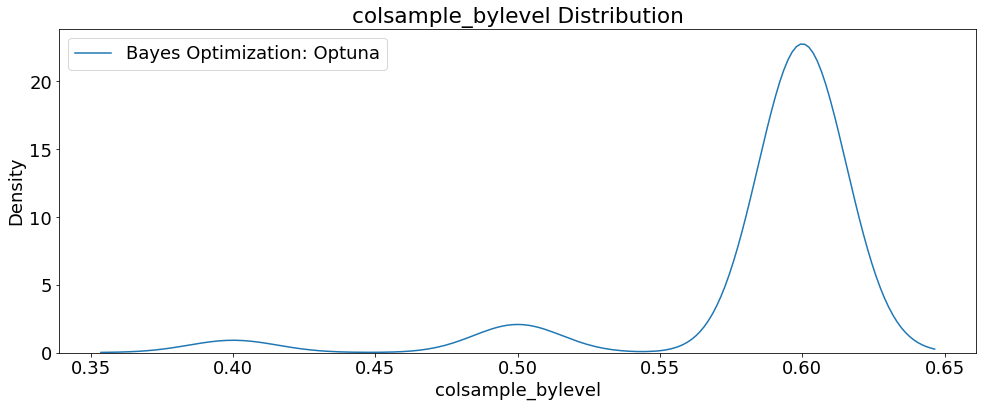

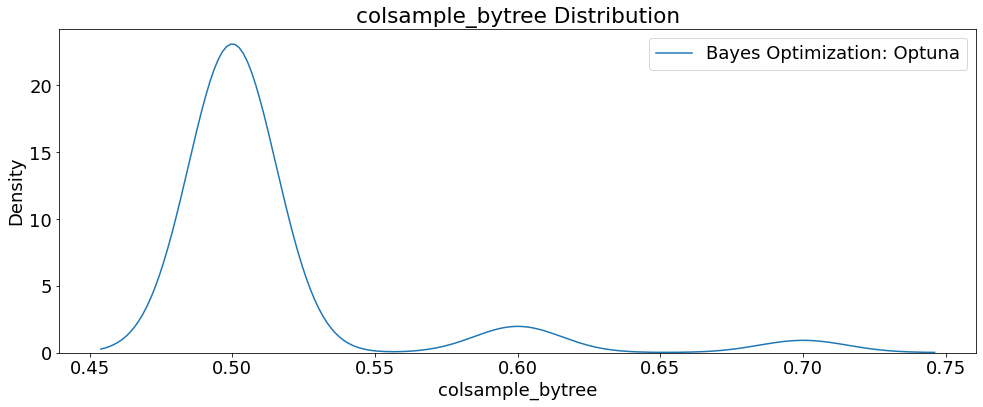

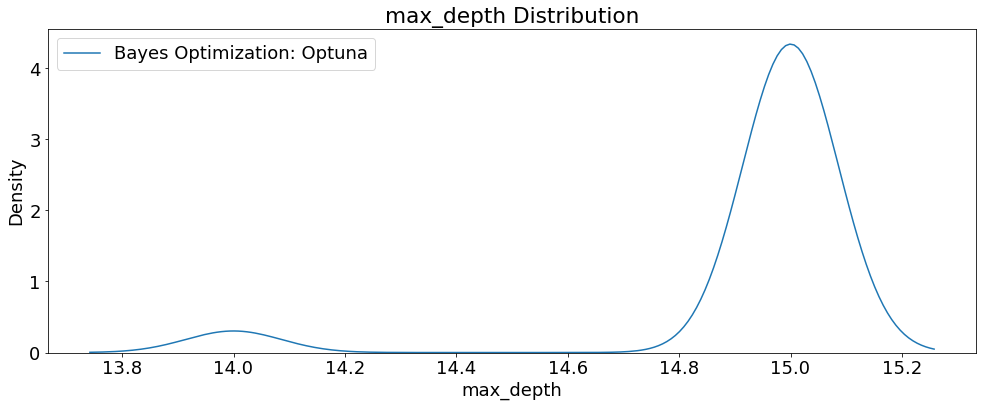

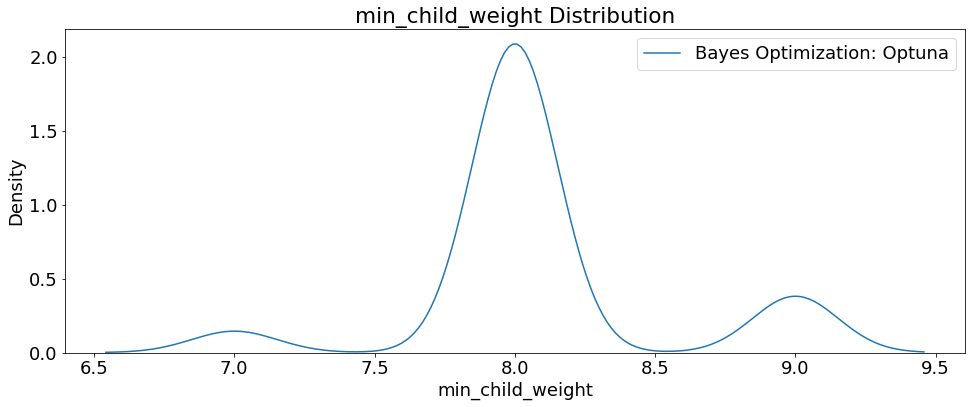

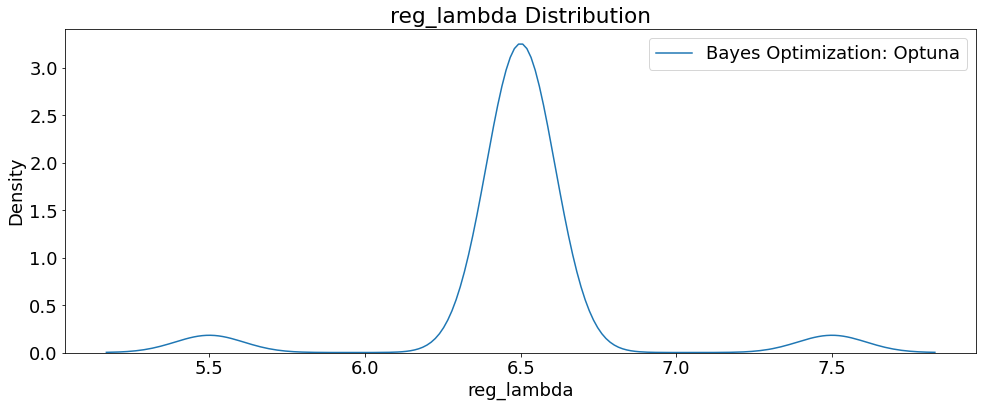

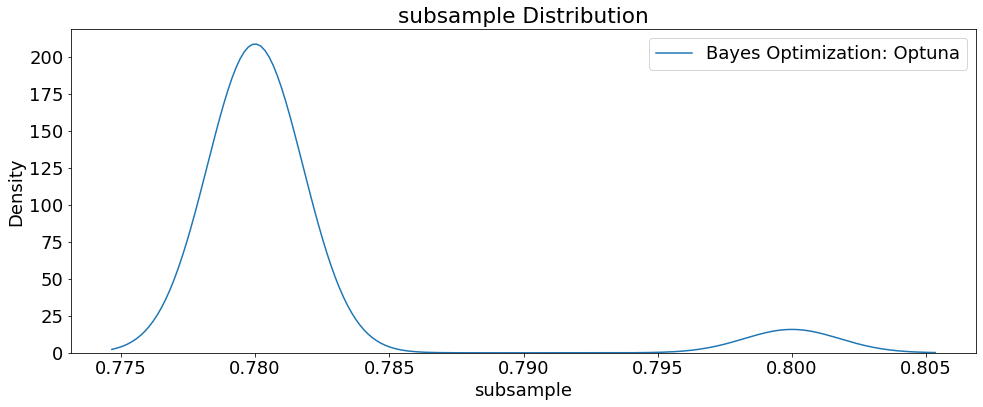

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

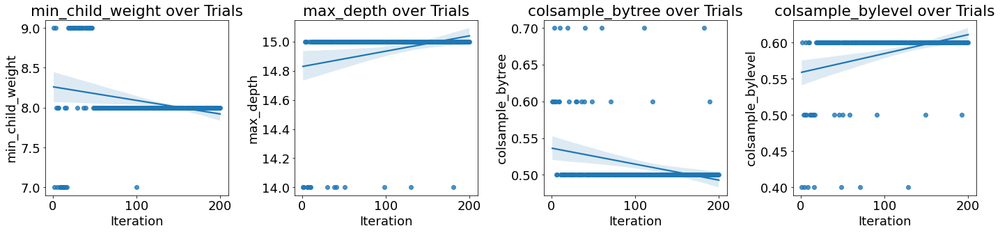

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
for i, hpo in enumerate(['min_child_weight', 'max_depth', 
                         'colsample_bytree', 'colsample_bylevel']): 
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_XGBoost_Optuna_GPU_setParams_P5000_cuml_wb.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_XGBoost_Optuna_GPU_setParams_P5000_cuml_wb.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params

{'n_estimators': 800,
 'max_depth': 15,
 'subsample': 0.78,
 'reg_lambda': 6.5,
 'colsample_bytree': 0.5,
 'colsample_bylevel': 0.6,
 'min_child_weight': 8,
 'random_state': 42,
 'metric': 'rmse'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = XGBRegressor(objective='reg:squarederror', 
                          booster='gbtree',
                          tree_method='gpu_hist', 
                          scale_pos_weight=1,
                          gamma=4.5,
                          learning_rate=0.04,
                          reg_alpha=0.01,
                          use_label_encoder=False,
                          verbosity=0, 
                          **params)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'XGB_Optuna_trials_GPU_setParams_P5000_cuml_wb.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('XGB_Optuna_trials_GPU_setParams_P5000_cuml_wb.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for XGBoost HPO GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_absolute_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred), 
                           squared=False),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred), 
                           squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(asnumpy(train_label), asnumpy(y_train_pred)),
        r2_score(asnumpy(test_label), asnumpy(y_test_pred))))


Model Metrics for XGBoost HPO GPU trials
MAE train: 968.912, test: 1680.328
MSE train: 1809196.456, test: 5346973.555
RMSE train: 1345.064, test: 2312.352
R^2 train: 0.980, test: 0.941


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(asnumpy(test_label), 
                                                                                                      asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 5346973.55547 MSE on the test set.
This was achieved using these conditions:
iteration                                   200
rmse                                2312.352386
datetime_start       2023-01-29 20:10:36.175346
datetime_complete    2023-01-29 20:12:46.949914
duration                 0 days 00:02:10.774568
colsample_bylevel                           0.6
colsample_bytree                            0.5
max_depth                                  15.0
min_child_weight                            8.0
n_estimators                              800.0
reg_lambda                                  6.5
subsample                                  0.78
state                                  COMPLETE
Name: 200, dtype: object
